## Graph tool

- read paper - done
- add two more small countries - done
- play around with the order of graphs according to lecture notes
- add time dimension - done
- no connection with the real world in the decription of the graphs

Note on running this .ipynb file: This file is running using graph-tool installed on the wsl:Ubuntu (Linux for Windows). Before running this file you will need to install graph-tool to your PC (different methods for Windows and McBooks) or configure graph-tool on Google Colab. Below you find commented out, code to configure Google Colab.

In [ ]:
#!echo "deb http://downloads.skewed.de/apt jammy main" >> /etc/apt/sources.list
#!apt-key adv --keyserver keyserver.ubuntu.com --recv-key 612DEFB798507F25
#!apt-get update
#!apt-get install python3-graph-tool python3-matplotlib python3-cairo

In [ ]:
#!apt purge python3-cairo
#!apt install libcairo2-dev pkg-config python3-dev
#!pip install --force-reinstall pycairo
#!pip install zstandard

In [9]:
import graph_tool.all as gt

In [13]:
#import graph_tool.all as gt
import matplotlib.pyplot as plt
import numpy as np
import matplotlib
import os
import matplotlib.image as mpimg
import geopandas as gpd
import matplotlib.cm as cm
import matplotlib.colors as colors  

### example of loading a pre-defined graph

In [11]:
countries_years = [
    ('AT', '2008'),
    ('BG', '2008'),
    ('CY', '2008'),
    ('DK', '2008'),
    ('AT', '2016'),
    ('BG', '2016'),
    ('CY', '2016'),
    ('DK', '2016')
]

# Create a dictionary to hold your data
datasets = {}

# Iterate over each country/year pair and retrieve the corresponding dataset
for country_code, year in countries_years:
    dataset_name = f"{country_code}_{year}"  # This will be the key, e.g., 'AT_2016'
    full_dataset_name = f"eu_procurements_alt/{dataset_name}"  # This is the full path used to retrieve the dataset
    datasets[dataset_name] = gt.collection.ns[full_dataset_name]

# Now we have a dictionary where the keys are 'AT_2016', 'CY_2008', etc.,
# and the values are the data you've retrieved

### basic numbers

In [4]:
print(datasets['CY_2008'])

<Graph object, undirected, with 443 vertices and 425 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x7f5b7ee07d00>


In [7]:
datasets['AT_2008'].list_properties()

name             (graph)   (type: string, val: eu_procurements_alt (AT_2008))
description      (graph)   (type: string, val: These 234 networks represent the
                                               annual national public
                                               procurement markets of 26
                                               European countries from
                                               2008-2016, inclusive. Data is
                                               sourced from Tenders Electronic
                                               Daily (TED), the official
                                               procurement portal of the
                                               European Union.  Nodes with the
                                               suffix "_i" are issuers
                                               (sometimes referred to as
                                               buyers) of public contracts, for
                       

In [17]:
# Extract the largest component from the dataset
u = gt.extract_largest_component(datasets['AT_2008'], prune=True)

# Retrieve the 'count' and 'pctSingleBid' edge properties
edge_count = u.ep["count"]
edge_pctSingleBid = u.ep["pctSingleBid"]

# Create a new edge property for the matplotlib color mapping
edge_color = u.new_edge_property('vector<double>')

# Create a color map that maps low 'pctSingleBid' values to one color and high values to another
cmap = plt.get_cmap('coolwarm')

# Normalize the 'pctSingleBid' values to the range [0, 1] for the color mapping
max_pctSingleBid = 1  # Maximum value for normalization
min_pctSingleBid = 0  # Minimum value for normalization
norm = colors.Normalize(vmin=min_pctSingleBid, vmax=max_pctSingleBid)  # Normalization function

for e in u.edges():
    # Normalize the 'pctSingleBid' value to the range [0, 1]
    normalized_value = norm(edge_pctSingleBid[e])
    edge_color[e] = cmap(normalized_value)  # Get the RGBA value from the colormap

# Now, when you draw the graph, you can use the 'edge_color' property for the colors
# and the 'edge_count' property converted to float for the weights.
pos = gt.sfdp_layout(u, eweight=edge_count)  # Using sfdp layout for a better spatial distribution
gt.graph_draw(u, pos=pos,
              vertex_fill_color=[0.5, 0.5, 0.5, 1.0],  # Grey vertices
              edge_color=edge_color,
              edge_pen_width=gt.prop_to_size(edge_count, mi=0.5, ma=50, power=1),
              output="graph_with_weighted_colored_edges.png")


<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f95c269a530, at 0x7f95d1dbbf40>

In [20]:
def draw_weighted_colored_graph(u, edge_color_property_name='edge_color'):
    """
    Prepares edge color and pen width based on 'count' and 'pctSingleBid' properties.
    Designed to be used within gt.graph_draw.
    :param u: The graph for which the drawing parameters are being prepared.
    :param edge_color_property_name: The name to be assigned to the new edge color property.
    :return: A dictionary with the edge_color and edge_pen_width properties.
    """
    # Retrieve the 'count' and 'pctSingleBid' edge properties
    edge_count = u.ep["count"]
    edge_pctSingleBid = u.ep["pctSingleBid"]

    # Create a new edge property for the matplotlib color mapping
    edge_color = u.new_edge_property('vector<double>')
    u.ep[edge_color_property_name] = edge_color

    # Create a color map and normalization instance
    cmap = plt.get_cmap('coolwarm')
    norm = colors.Normalize(vmin=0, vmax=1)  # 'pctSingleBid' is always between 0 and 1

    # Assign colors to edges based on 'pctSingleBid' values
    for e in u.edges():
        normalized_value = norm(edge_pctSingleBid[e])
        edge_color[e] = cmap(normalized_value)

    # Prepare the dictionary with drawing parameters
    drawing_parameters = {
        'edge_color': edge_color,
        'edge_pen_width': gt.prop_to_size(edge_count, mi=0.5, ma=50, power=1)
    }
    
    return drawing_parameters





In [21]:
# Example usage:
output_dir = "output_graphs"
os.makedirs(output_dir, exist_ok=True)

for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u)
    output_path = os.path.join(output_dir, f"{dataset_key}.png")
    
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos=pos, output=output_path, **drawing_parameters)

### in- and out-degree distribution

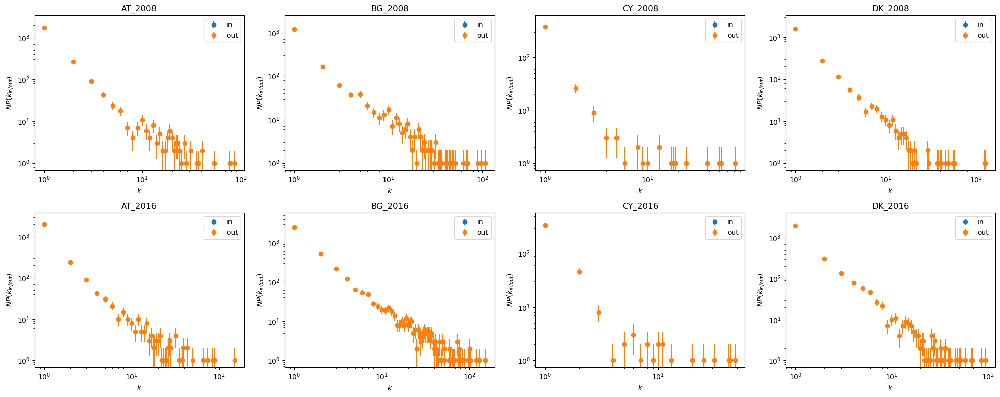

In [6]:
# Determine the layout of the subplots (you may need to adjust these numbers)
cols = 4
rows = int(np.ceil(len(datasets) / float(cols)))

# Create a figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (dataset_key, g) in enumerate(datasets.items()):
    ax = axes[i]

    in_hist = gt.vertex_hist(g, "in")
    out_hist = gt.vertex_hist(g, "out")

    y_in = in_hist[0]
    err_in = np.sqrt(in_hist[0])

    y_out = out_hist[0]
    err_out = np.sqrt(out_hist[0])

    ax.errorbar(in_hist[1][:-1], y_in, fmt="o", yerr=err_in, label="in")
    ax.errorbar(out_hist[1][:-1], y_out, fmt="o", yerr=err_out, label="out")

    ax.set_yscale("log")
    ax.set_xscale("log")

    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k_{in/out})$")
    ax.set_title(dataset_key)
    ax.legend()

# Hide any unused subplots if the number of plots isn't a perfect grid
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


### spring layout

In [8]:
# Ensure the output directory exists
output_dir = "output"
os.makedirs(output_dir, exist_ok=True)

# Loop through each dataset and save the graph as an image
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u)
    output_path = os.path.join(output_dir, f"{dataset_key}.png")
    gt.graph_draw(u, pos, output=output_path,  **drawing_parameters)


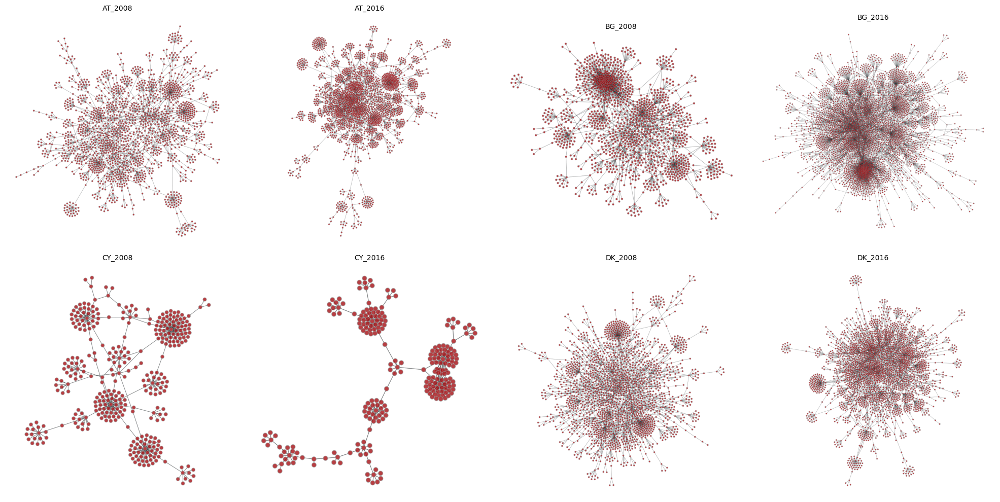

In [10]:
# Get the list of all saved images
image_files = sorted([os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files) / float(cols)))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each image file and add it to the subplot
for i, image_file in enumerate(image_files):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off the axis
    # Set the title for the subplot using the filename
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots if the number of plots isn't a perfect grid
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.show()


### Fruchterman reingold version

In [12]:
# Ensure the output directory exists for Fruchterman-Reingold layouts
output_dir_fr = "output_fr"
os.makedirs(output_dir_fr, exist_ok=True)

In [20]:
# Loop through each dataset and save the graph with Fruchterman-Reingold layout as an image
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    pos_fr = gt.fruchterman_reingold_layout(u, n_iter=100)  # Set the number of iterations if needed
    output_path = os.path.join(output_dir_fr, f"{dataset_key}.png")
    gt.graph_draw(u, pos_fr, output=output_path)


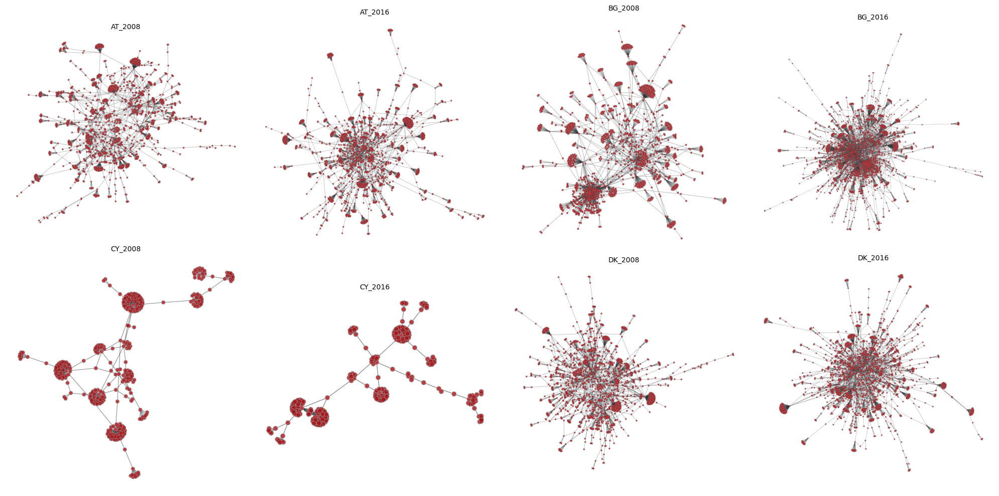

In [13]:
# Get the list of all saved images for Fruchterman-Reingold layouts
image_files_fr = sorted([os.path.join(output_dir_fr, f) for f in os.listdir(output_dir_fr) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_fr) / float(cols)))

# Create the figure with subplots for Fruchterman-Reingold layouts
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for Fruchterman-Reingold layouts and add it to the subplot
for i, image_file in enumerate(image_files_fr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


In [14]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "output_vp"
os.makedirs(output_dir_vp, exist_ok=True)

In [24]:
# Loop through each dataset and save the graph using the stored positions as an image
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)    
    output_path = os.path.join(output_dir_vp, f"{dataset_key}.png")
    gt.graph_draw(u, pos=u.vp["_pos"], output=output_path)


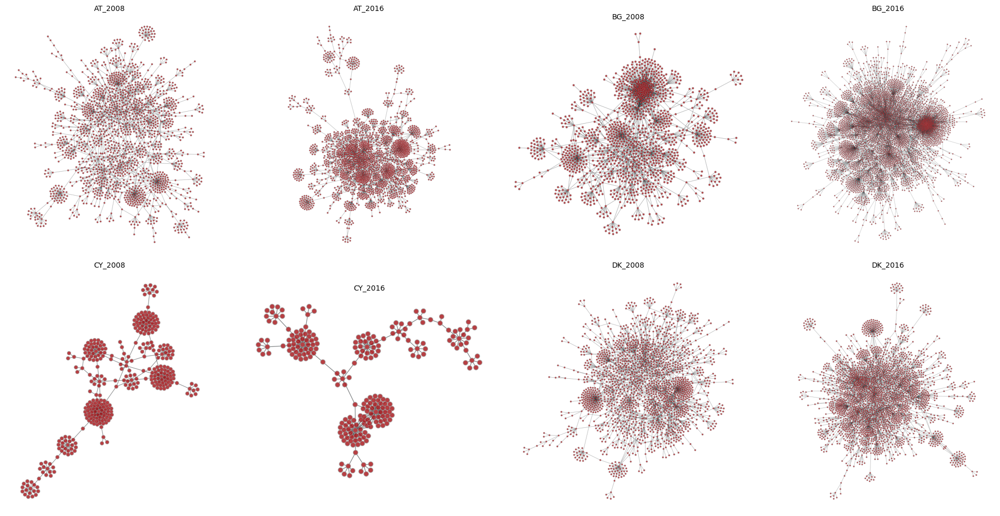

In [15]:
# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_vp) / float(cols)))

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


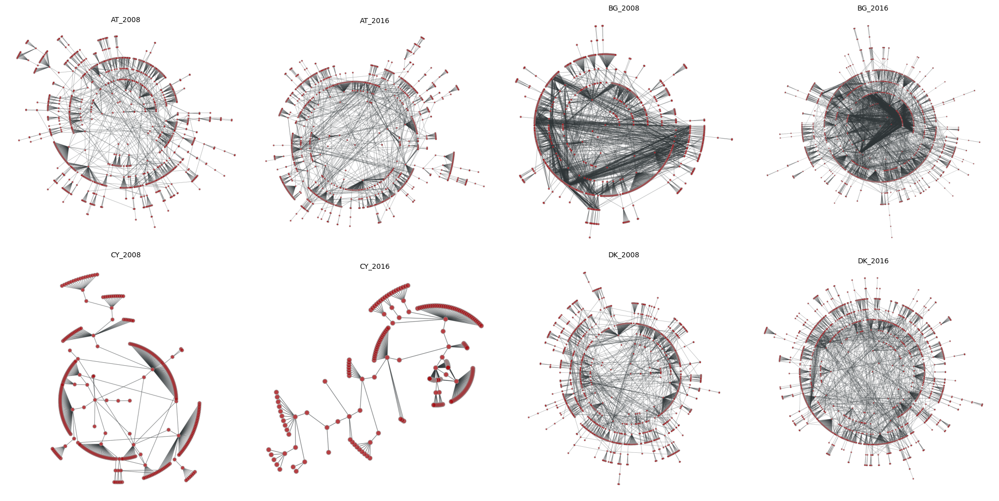

In [22]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "output_vp"
os.makedirs(output_dir_vp, exist_ok=True)

# Assume datasets is a dict with Graph-tool graphs
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)    
    pos_tree = gt.radial_tree_layout(u, u.vertex(0))
    output_path = os.path.join(output_dir_vp, f"{dataset_key}.png")
    gt.graph_draw(u, pos=pos_tree, output=output_path)

# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_vp) / float(cols)))

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    # Read each graph from its saved file
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


Graph: AT_2008
Vertices with the maximum in-degree: [   0    1    2 ... 1681 1682 1683]
In-degrees of all vertices: [0 0 0 ... 0 0 0]
Graph: BG_2008
Vertices with the maximum in-degree: [   0    1    2 ... 1378 1379 1380]
In-degrees of all vertices: [0 0 0 ... 0 0 0]
Graph: CY_2008
Vertices with the maximum in-degree: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 16

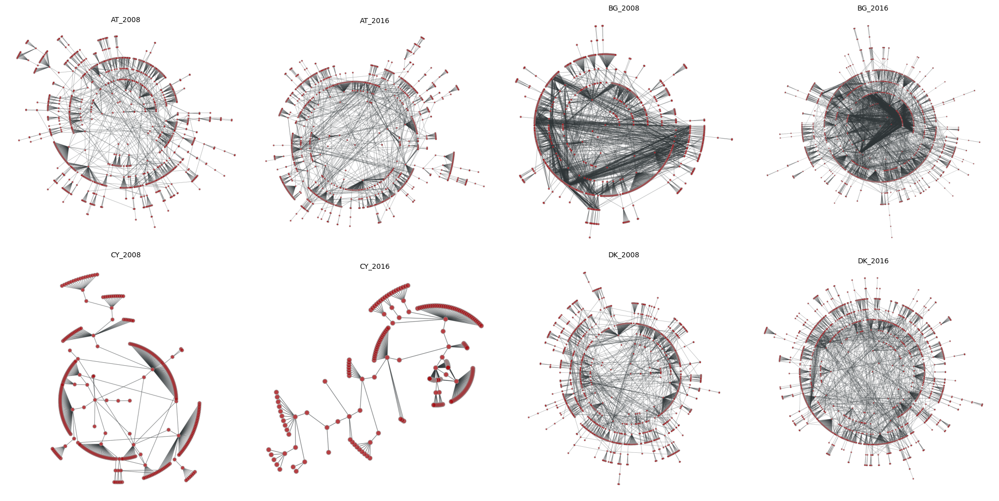

In [27]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "output_vp"
os.makedirs(output_dir_vp, exist_ok=True)

# Process each graph to find the vertex with the maximum in-degree
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    
    # Find the vertex with the maximum in-degree
    in_degrees = u.get_in_degrees(u.get_vertices())
    maximum = max(in_degrees)
    max_in_degree_vertices = np.where(in_degrees == maximum)[0]

    # Print information about the maximum in-degree
    print(f"Graph: {dataset_key}")
    print("Vertices with the maximum in-degree:", max_in_degree_vertices)
    print("In-degrees of all vertices:", in_degrees)

    # If there are multiple vertices with the maximum in-degree, choose one
    central_vertex = u.vertex(max_in_degree_vertices[0])

    # Compute the radial tree layout from the central vertex
    pos_tree = gt.radial_tree_layout(u, central_vertex)
    
    # Save the graph drawing with radial tree layout
    output_path = os.path.join(output_dir_vp, f"{dataset_key}.png")
    gt.graph_draw(u, pos=pos_tree, output=output_path)

# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_vp) / float(cols)))

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    # Read each graph from its saved file
    img = plt.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


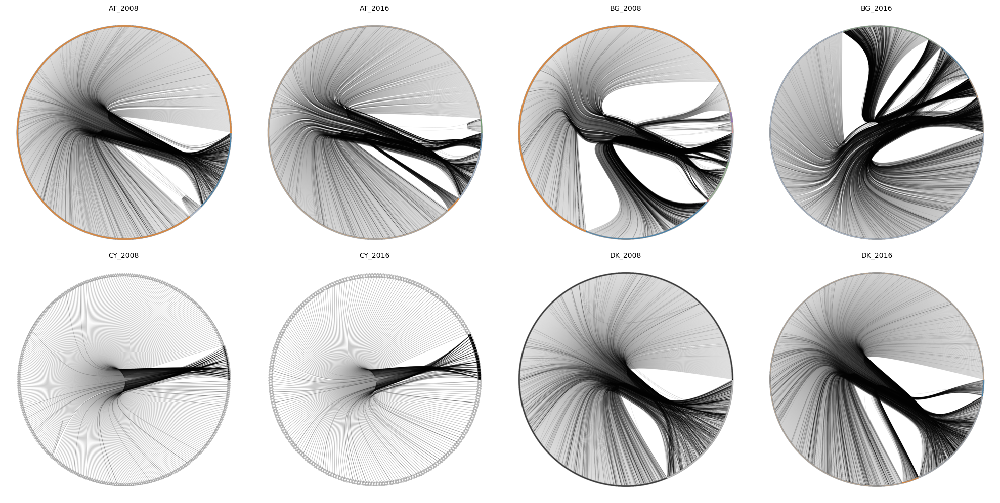

In [30]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "output_vp"
os.makedirs(output_dir_vp, exist_ok=True)

# Process each graph to create a nested blockmodel and visualize it
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    
    # Minimize the nested blockmodel
    state = gt.minimize_nested_blockmodel_dl(u)
    
    # Get the hierarchy tree and compute the layout
    t = gt.get_hierarchy_tree(state)[0]
    tpos = gt.radial_tree_layout(t, t.vertex(t.num_vertices() - 1, use_index=False), weighted=True)
    cts = gt.get_hierarchy_control_points(u, t, tpos)
    pos = u.own_property(tpos)
    
    # Get the block labels for coloring the vertices
    b = state.levels[0].b
    
    # Copy the block labels and take modulo for shaping
    shape = b.copy()
    shape.a %= 14  # This will result in 14 different shapes
    
    # Draw the graph with the computed layout and save it
    output_path = os.path.join(output_dir_vp, f"{dataset_key}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=b, vertex_shape=shape,
                  edge_control_points=cts, edge_color=[0, 0, 0, 0.3], 
                  vertex_anchor=0, output=output_path)

# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_vp) / float(cols)))

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    # Read each graph from its saved file
    img = plt.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### shortest paths

Graph: AT_2008
[ 1  0  2 ...  9 10 10]
Graph: BG_2008
[1 0 2 ... 6 6 6]
Graph: CY_2008
[ 1  0  2  1  2  2  2  2  2  2  2  2  9 10 10 10 10  8 10 10 10 10 10 10
 10 10 10 10 10 10  5  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  4
  6  6  6  6  6  6  6  6  4  6  6  6  6  6  6  6  6  6  6  6  6  6  6  4
  6  6  6  6  6  6  6  6  6  6  6  7  8  8  8  8  8  8  8  3  4  4  4  4
  4  4  4  5  4  6  6  3  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  5  4  5  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  4  6  6  6  6  6  6  6  6  5
  6  6  6  5  6  6  5  6  4  6  6  6  6  6  6  6  6  3  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  5  6  6  6  4  6  6  6  6
  6  3  4  4  4  4  4  4  4  4  4  4  4  4  4  7  8  8  8  8  8  8  8  8
  8  8  8  3  4  4  4  4  4  4  4  4 

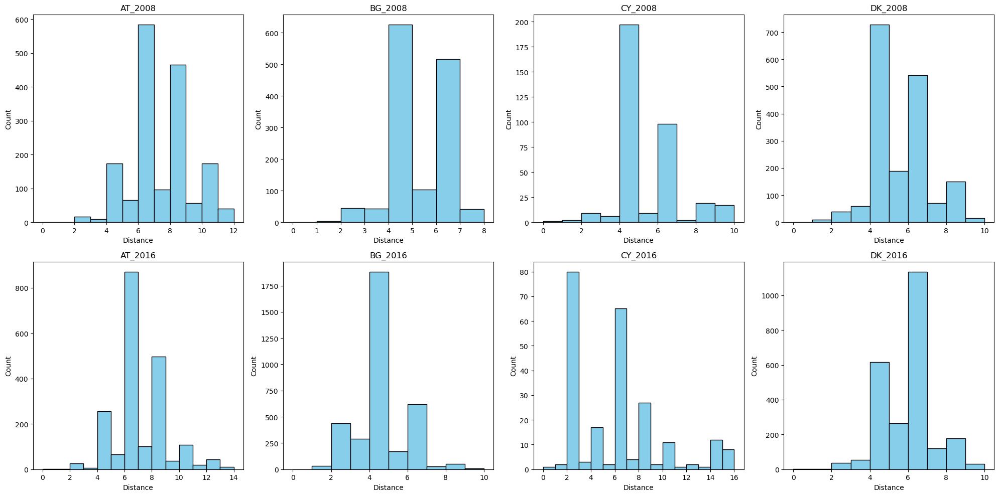

In [31]:
# Assuming datasets is a dictionary with Graph-tool graph objects
output_dir_vp = "output_vp"
os.makedirs(output_dir_vp, exist_ok=True)

# Set the number of columns for your faceted histograms
cols = 4
# Calculate the number of rows we will need
rows = int(np.ceil(len(datasets) / cols))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Loop through each graph and calculate shortest distances
for i, (dataset_key, g) in enumerate(datasets.items()):
    u = gt.extract_largest_component(g, prune=True)
    
    # Calculate shortest distances from vertex 1
    dist = gt.shortest_distance(u, source=u.vertex(1))
    print(f"Graph: {dataset_key}")
    print(dist.a)  # Print the shortest distances for each vertex
    
    # Plot histogram of distances on the subplot
    ax = axes_flat[i]
    ax.hist(dist.a, bins=range(int(max(dist.a)) + 1), color='skyblue', edgecolor='black')
    ax.set_title(dataset_key)
    ax.set_xlabel('Distance')
    ax.set_ylabel('Count')

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


Graph: AT_2008
[0.00000e+00 3.84200e+03 4.47440e+04 5.12860e+04 3.29372e+05 2.11310e+05
 9.21470e+05 2.77094e+05 6.39506e+05 1.29958e+05 1.71854e+05 2.78240e+04
 2.01400e+04 3.53400e+03 1.88000e+03 2.62000e+02 9.60000e+01]
Graph: BG_2008
[0.00000e+00 4.68800e+03 6.98160e+04 8.22980e+04 5.16870e+05 2.03100e+05
 7.09872e+05 9.74960e+04 1.89960e+05 1.09580e+04 1.88880e+04 6.12000e+02
 1.14400e+03 2.40000e+01 5.40000e+01]
Graph: CY_2008
[    0.   736. 13770.  2808. 24226.  4508. 46454.  3532. 18568.  1166.
  6342.   682.  5640.   168.   640.]
Graph: DK_2008
[0.00000e+00 4.42600e+03 6.62280e+04 8.77420e+04 5.09438e+05 3.96116e+05
 1.04802e+06 3.69340e+05 5.22138e+05 1.05424e+05 1.04100e+05 1.62220e+04
 1.37880e+04 1.30000e+03 1.03600e+03 5.40000e+01 3.00000e+01]
Graph: AT_2016
[0.000000e+00 4.814000e+03 8.325800e+04 8.500200e+04 7.448740e+05
 2.993320e+05 1.394906e+06 2.813100e+05 7.631540e+05 1.339120e+05
 2.429560e+05 5.244400e+04 6.520800e+04 1.373600e+04 8.680000e+03
 1.550000e+03 6.640

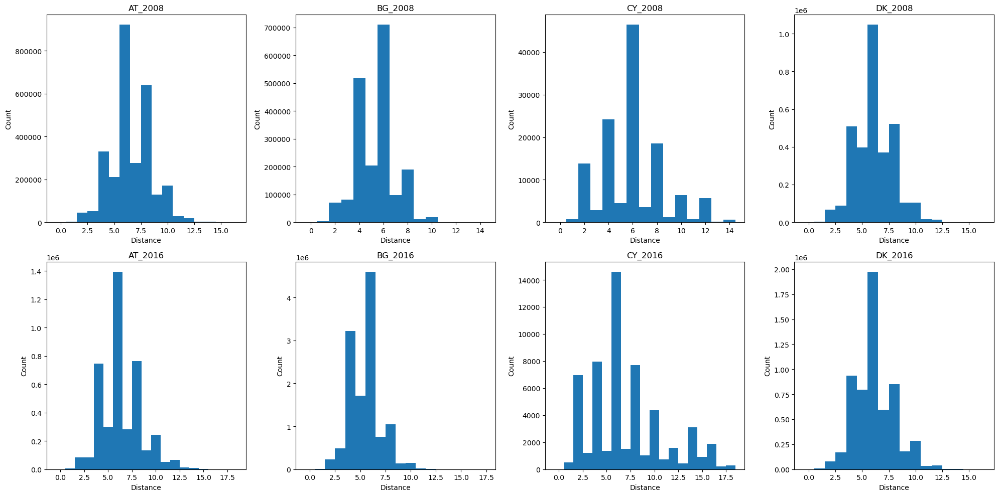

In [32]:
import os
import numpy as np
import matplotlib.pyplot as plt
import graph_tool.all as gt

# Assuming 'datasets' is a dictionary with graph_tool graph objects
output_dir_vp = "output_vp"
os.makedirs(output_dir_vp, exist_ok=True)

# Determine the number of rows and columns for the facet grid
cols = 4
rows = int(np.ceil(len(datasets) / cols))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Process each graph to calculate and plot the distance histogram
for i, (dataset_key, g) in enumerate(datasets.items()):
    u = gt.extract_largest_component(g, prune=True)
    
    # Calculate distance histogram using graph_tool
    hist, bin_edges = gt.distance_histogram(u)
    print(f"Graph: {dataset_key}")
    print(hist)  # Print the histogram for each graph
    
    # Plot the histogram of distances on the subplot
    ax = axes_flat[i]
    ax.bar(bin_edges[:-1], hist, width=1)
    ax.set_title(dataset_key)
    ax.set_xlabel('Distance')
    ax.set_ylabel('Count')

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


In [33]:
# Assuming 'datasets' is a dictionary with graph_tool graph objects
# Loop through each graph and calculate the average shortest path length
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    
    # Calculate shortest distances for all pairs
    dist = gt.shortest_distance(u)
    
    # Calculate and print the average path length
    average_path_length = gt.vertex_average(u, dist)
    print(f"Graph: {dataset_key}, Average path length: {np.mean(average_path_length)}")


Graph: AT_2008, Average path length: 3.320270693615452
Graph: BG_2008, Average path length: 2.704077615560222
Graph: CY_2008, Average path length: 3.023120307258224
Graph: DK_2008, Average path length: 3.0719659373696224
Graph: AT_2016, Average path length: 3.2112424080908455
Graph: BG_2016, Average path length: 2.745128053416263
Graph: CY_2016, Average path length: 3.6261328359183063
Graph: DK_2016, Average path length: 3.092627544412773


### percolation threshold

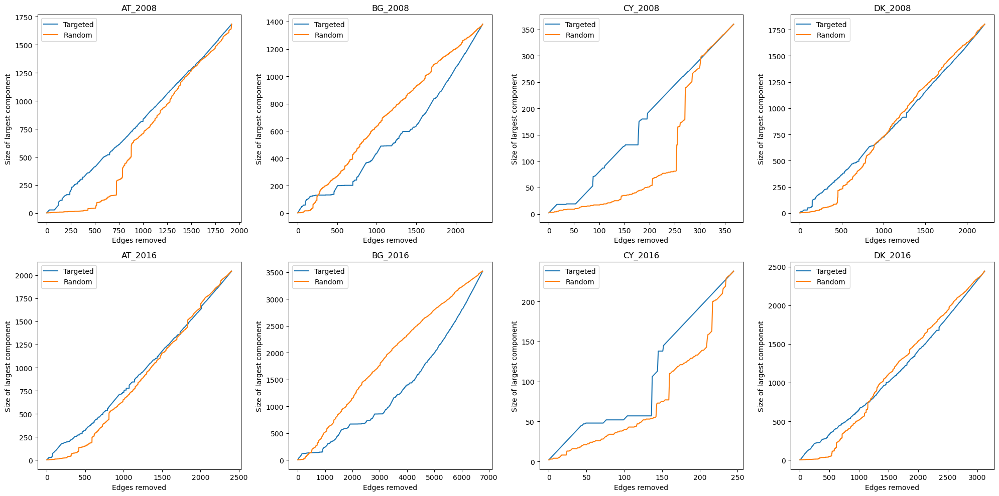

In [36]:
# Assuming 'datasets' is a dictionary with graph_tool graph objects
# Determine the number of rows and columns for the facet grid
cols = 4
rows = int(np.ceil(len(datasets) / cols))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Process each graph to calculate and plot the edge percolation
for i, (dataset_key, g) in enumerate(datasets.items()):
    u = gt.extract_largest_component(g, prune=True)

    # Calculate edges sorted by the product of their vertex degrees for targeted percolation
    edges = sorted([(e.source(), e.target()) for e in u.edges()],
                   key=lambda e: e[0].in_degree() * e[1].in_degree(), reverse=True)

    # Perform targeted edge percolation
    sizes, comp = gt.edge_percolation(u, edges)

    # Shuffle edges for random percolation
    np.random.shuffle(edges)
    sizes2, comp2 = gt.edge_percolation(u, edges)

    # Plot the results on the subplot
    ax = axes_flat[i]
    ax.plot(sizes, label="Targeted")
    ax.plot(sizes2, label="Random")
    ax.set_title(dataset_key)
    ax.set_xlabel('Edges removed')
    ax.set_ylabel('Size of largest component')
    ax.legend()

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### k-core decomposition

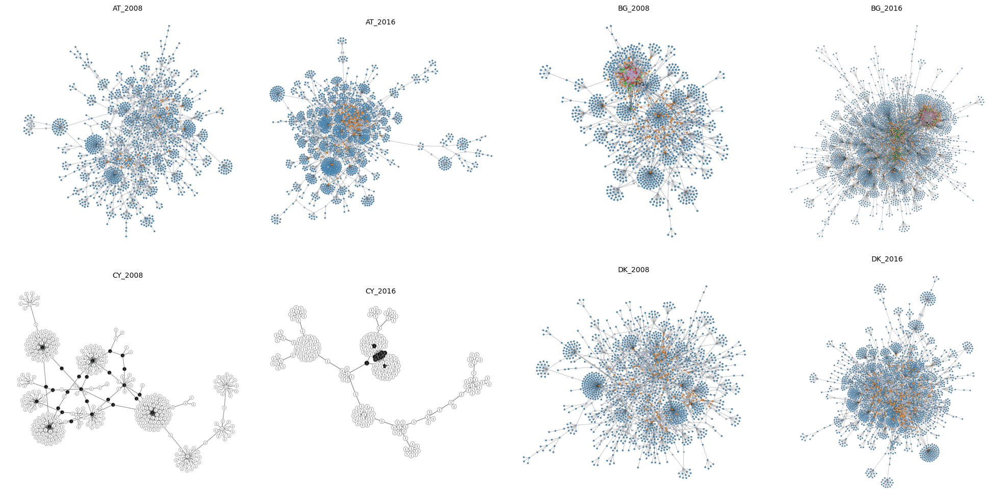

In [37]:
# Ensure the output directory exists for the stored images
output_dir_kcore = "kcore_images"
os.makedirs(output_dir_kcore, exist_ok=True)

# Generate k-core decomposition images for each graph
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    kcore = gt.kcore_decomposition(u)
    output_path = os.path.join(output_dir_kcore, f"{dataset_key}.png")
    gt.graph_draw(u, vertex_fill_color=kcore, vertex_text=kcore, output=output_path)

# Get the list of all saved images for the k-core decompositions
image_files_kcore = sorted([os.path.join(output_dir_kcore, f) for f in os.listdir(output_dir_kcore) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_kcore) / float(cols)))

# Create the figure with subplots for the k-core decompositions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Loop through each image file for the k-core decompositions and add it to the subplot
for i, image_file in enumerate(image_files_kcore):
    img = mpimg.imread(image_file)
    axes_flat[i].imshow(img)
    axes_flat[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes_flat[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


In [45]:
# Initialize a dictionary to store the pseudo diameters
pseudo_diameters = {}

# Calculate the pseudo diameter for each graph and store the information
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    
    # Get the pseudo diameter and the end vertices of the path
    pseudo_diam, end_points = gt.pseudo_diameter(u)
    
    # Find the shortest path between the end_points, which represents the pseudo diameter
    path = gt.shortest_path(u, source=end_points[0], target=end_points[1])[0]
    
    # Store the results
    pseudo_diameters[dataset_key] = {
        'pseudo_diameter': pseudo_diam,
        'path_length': len(path),
        'end_points': (int(end_points[0]), int(end_points[1]))
    }

# Display the results in a neatly formatted table
header = f"{'Graph':<20}{'Pseudo Diameter':<20}{'Path Length':<15}{'End Points':<30}"
print(header)
print("-" * len(header))  # Print a separator line

for key, value in pseudo_diameters.items():
    end_points_str = f"({value['end_points'][0]}, {value['end_points'][1]})"
    print(f"{key:<20}{value['pseudo_diameter']:<20}{value['path_length']:<15}{end_points_str:<30}")


Graph               Pseudo Diameter     Path Length    End Points                    
-------------------------------------------------------------------------------------
AT_2008             16.0                17             (954, 295)                    
BG_2008             14.0                15             (1328, 1109)                  
CY_2008             14.0                15             (29, 184)                     
DK_2008             16.0                17             (653, 191)                    
AT_2016             18.0                19             (2030, 1027)                  
BG_2016             17.0                18             (647, 3495)                   
CY_2016             18.0                19             (139, 93)                     
DK_2016             15.0                16             (928, 2312)                   


### centrality measures

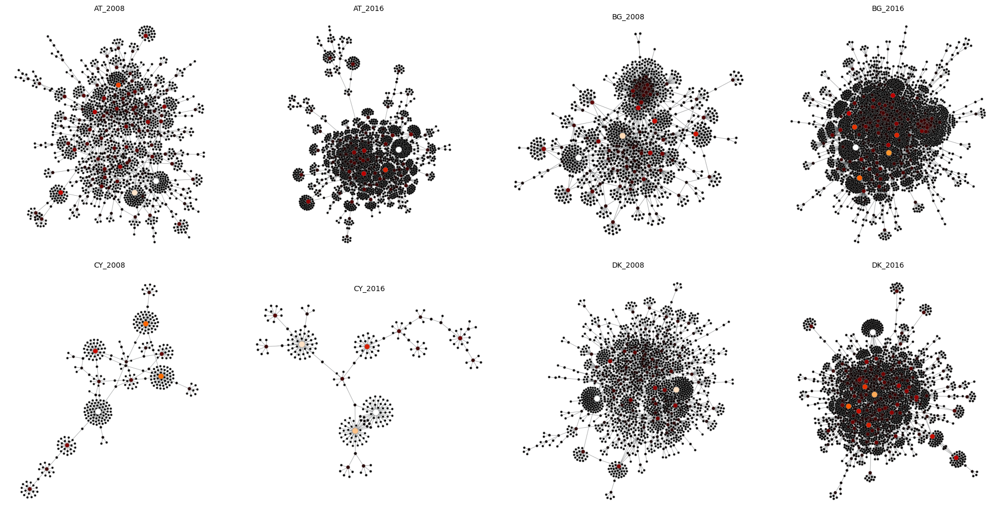

In [47]:
# Ensure the output directory exists for the PageRank images
output_dir_pr = "pagerank_images"
os.makedirs(output_dir_pr, exist_ok=True)

# Compute and visualize PageRank for each graph, and save as images
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    
    # Calculate PageRank
    pr = gt.pagerank(u)
    
    # Save the visualization as an image
    output_path = os.path.join(output_dir_pr, f"{dataset_key}.png")
    gt.graph_draw(u, pos=u.vp["_pos"], vertex_fill_color=pr,
                  vertex_size=gt.prop_to_size(pr, mi=5, ma=15),
                  vorder=pr, vcmap=matplotlib.cm.gist_heat,
                  output=output_path)

# Get the list of all saved images for PageRank visualizations
image_files_pr = sorted([os.path.join(output_dir_pr, f) for f in os.listdir(output_dir_pr) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_pr) / float(cols)))

# Create the figure with subplots for the PageRank visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for PageRank visualizations and add it to the subplot
for i, image_file in enumerate(image_files_pr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


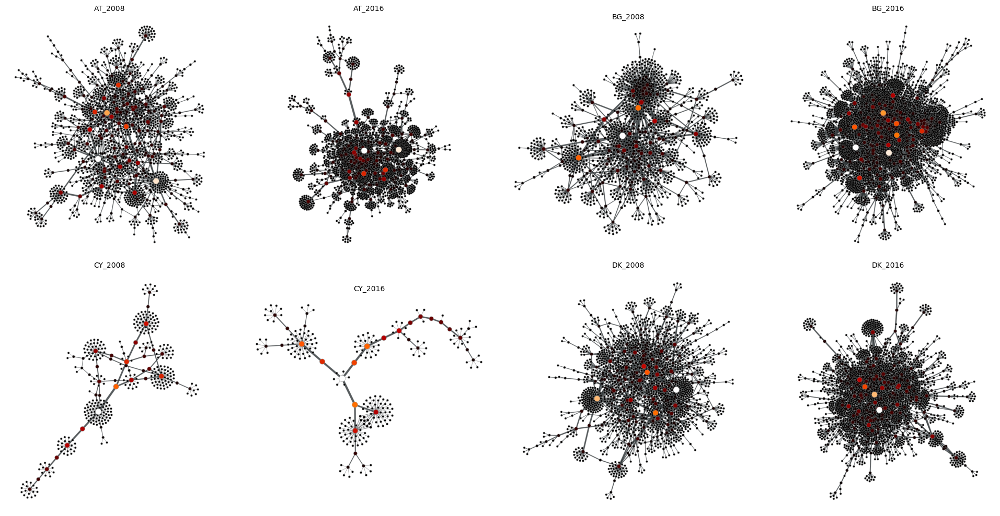

In [49]:
# Ensure the output directory exists for the betweenness images
output_dir_bt = "betweenness_images"
os.makedirs(output_dir_bt, exist_ok=True)

# Compute and visualize betweenness for each graph, and save as images
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    
    # Calculate betweenness
    vp, ep = gt.betweenness(u)
    
    # Save the visualization as an image
    output_path = os.path.join(output_dir_bt, f"{dataset_key}.png")
    gt.graph_draw(u, pos=u.vp["_pos"], vertex_fill_color=vp,
                  vertex_size=gt.prop_to_size(vp, mi=5, ma=15),
                  edge_pen_width=gt.prop_to_size(ep, mi=0.5, ma=5),
                  vcmap=cm.gist_heat, vorder=vp,
                  output=output_path)

# Get the list of all saved images for betweenness visualizations
image_files_bt = sorted([os.path.join(output_dir_bt, f) for f in os.listdir(output_dir_bt) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_bt) / float(cols)))

# Create the figure with subplots for the betweenness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for betweenness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bt):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


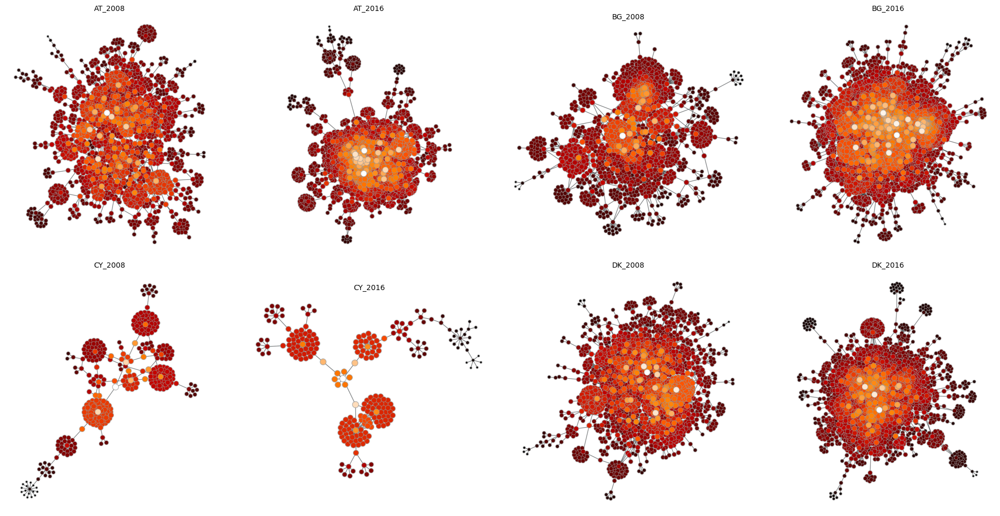

In [50]:
# Ensure the output directory exists for the closeness images
output_dir_cl = "closeness_images"
os.makedirs(output_dir_cl, exist_ok=True)

# Compute and visualize closeness for each graph, and save as images
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    
    # Calculate closeness centrality
    c = gt.closeness(u)
    
    # Save the visualization as an image
    output_path = os.path.join(output_dir_cl, f"{dataset_key}.png")
    gt.graph_draw(u, pos=u.vp["_pos"], vertex_fill_color=c,
                  vertex_size=gt.prop_to_size(c, mi=5, ma=15),
                  vcmap=cm.gist_heat, vorder=c,
                  output=output_path)

# Get the list of all saved images for closeness visualizations
image_files_cl = sorted([os.path.join(output_dir_cl, f) for f in os.listdir(output_dir_cl) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_cl) / float(cols)))

# Create the figure with subplots for the closeness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for closeness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_cl):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


Note: Decided against running eigenvector centrality because it was too computationally expensive. <br>
Note on clustering coefficient: 
The dataset you mentioned seems to describe a bipartite graph (nodes are either issuers "_i" or winners "_w", and edges exist only between issuers and winners). In a bipartite graph, there are no edges between nodes of the same set, and thus, by definition, the local clustering coefficient for every node is zero because there cannot be any triangles (which the clustering coefficient measures).
Given that the networks represent public procurement markets and are likely bipartite, the zero clustering coefficient might indeed be correct. For bipartite graphs, you might want to look at other metrics that are more informative for such structures, like bipartite density, matching index, or others that take into account the bipartite nature of the network.

If you are trying to calculate a clustering coefficient for a bipartite graph using tools or algorithms designed for general graphs, you should instead use metrics designed for bipartite graphs. There are definitions and algorithms for clustering coefficients in bipartite graphs that differ from those in general graphs, which could give you more meaningful insights for your data.

### Blockmodel

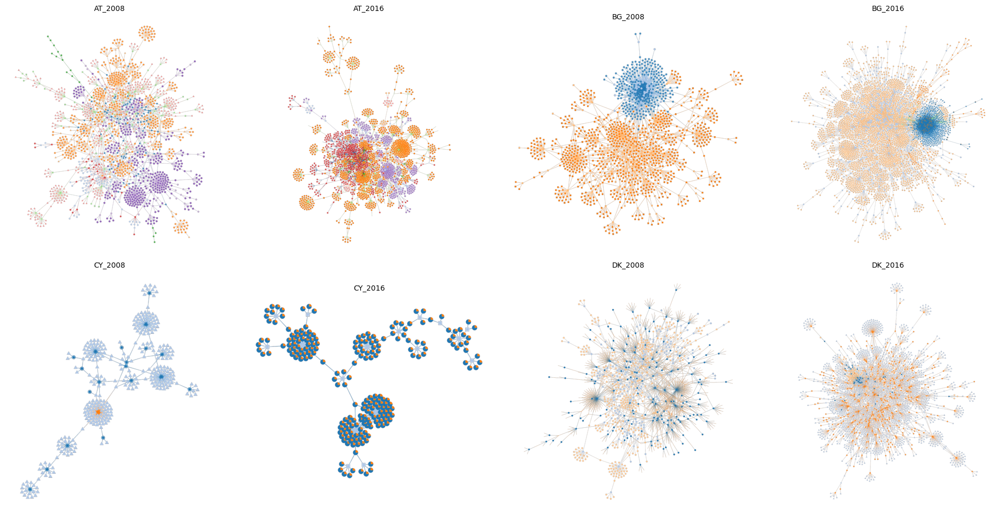

In [4]:
# Ensure the output directory exists for the blockmodel images
output_dir_bm = "blockmodel_images"
os.makedirs(output_dir_bm, exist_ok=True)

# Compute and visualize the blockmodel for each graph, and save as images
for dataset_key, g in datasets.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)
    
    # Minimize the blockmodel description length
    state = gt.minimize_blockmodel_dl(u)
    
    # Save the visualization as an image
    output_path = os.path.join(output_dir_bm, f"{dataset_key}.png")
    state.draw(pos=u.vp["_pos"], vertex_shape=state.get_blocks(), output=output_path)

# Get the list of all saved images for blockmodel visualizations
image_files_bm = sorted([os.path.join(output_dir_bm, f) for f in os.listdir(output_dir_bm) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_bm) / float(cols)))

# Create the figure with subplots for the blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


Fruchtermann-Reingold version

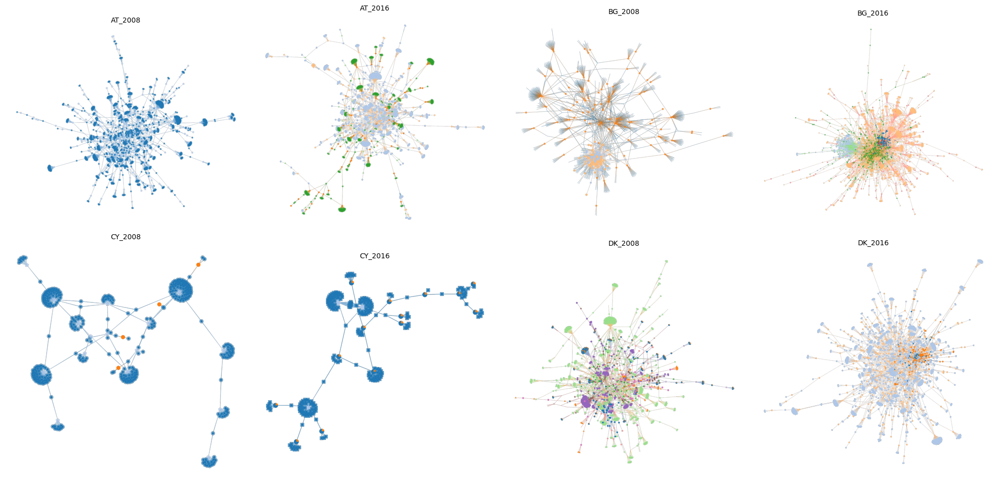

In [5]:
# Ensure the output directory exists for the blockmodel images
output_dir_bm = "blockmodel_fr_images"
os.makedirs(output_dir_bm, exist_ok=True)

# Compute and visualize the blockmodel for each graph, and save as images
for dataset_key, g in datasets.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)
    
    # Compute the Fruchterman-Reingold layout for u
    pos_fr = gt.fruchterman_reingold_layout(u, n_iter=100)  # You can adjust the iterations if needed
    
    # Minimize the blockmodel description length
    state = gt.minimize_blockmodel_dl(u)
    
    # Save the visualization as an image
    output_path = os.path.join(output_dir_bm, f"{dataset_key}.png")
    state.draw(pos=pos_fr, vertex_shape=state.get_blocks(), output=output_path)

# Get the list of all saved images for blockmodel visualizations
image_files_bm = sorted([os.path.join(output_dir_bm, f) for f in os.listdir(output_dir_bm) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_bm) / float(cols)))

# Create the figure with subplots for the blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


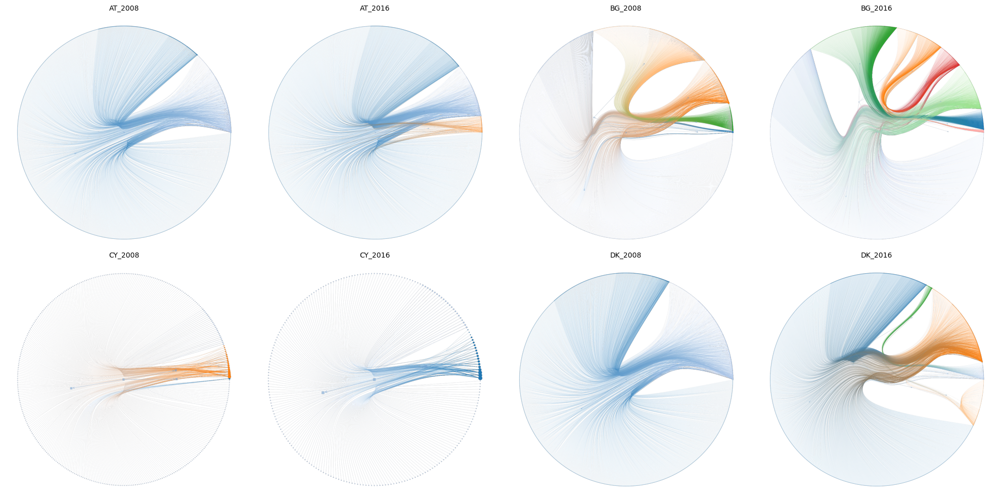

In [7]:
# Ensure the output directory exists for the nested blockmodel images
output_dir_nbm = "nested_blockmodel_images"
os.makedirs(output_dir_nbm, exist_ok=True)

# Compute and visualize the nested blockmodel for each graph, and save as images
for dataset_key, g in datasets.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)
    
    # Compute the nested blockmodel
    state2 = gt.minimize_nested_blockmodel_dl(u)
    
    # Save the visualization as an image
    output_path = os.path.join(output_dir_nbm, f"{dataset_key}.png")
    state2.draw(output=output_path)  # Draw and save the visualization

# Get the list of all saved images for nested blockmodel visualizations
image_files_nbm = sorted([os.path.join(output_dir_nbm, f) for f in os.listdir(output_dir_nbm) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_nbm) / float(cols)))

# Create the figure with subplots for the nested blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for nested blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_nbm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()
